# Wine Recommendation System
---------
# About the dataset


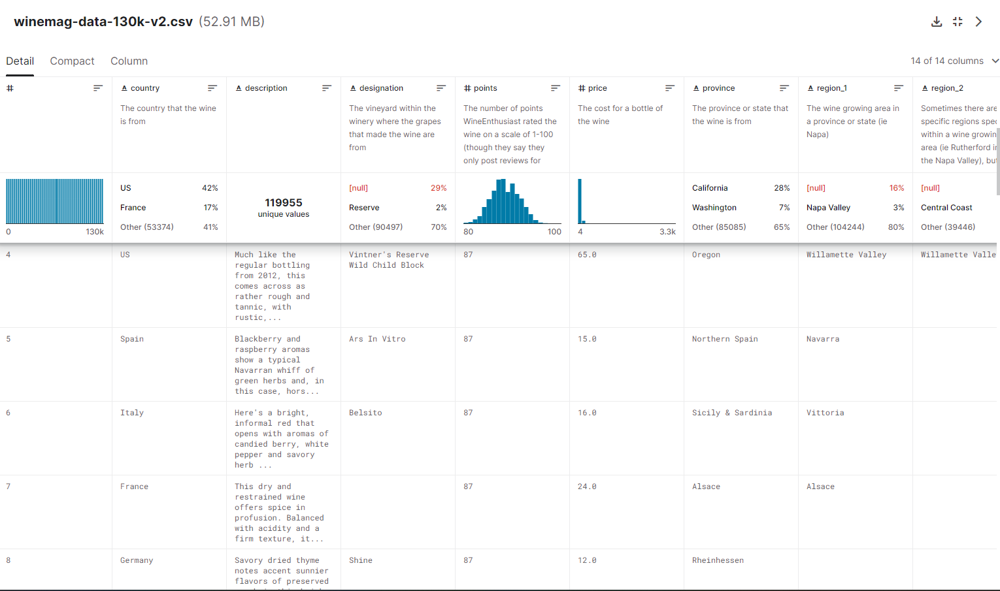

## Columns Description
+ __country__: The country that the wine is from
+ __description__: The WineEnthusiast description about the wine
+ __designation__: The vineyard within the winery where the grapes that made the wine are from
+ __points__: The number of points WineEnthusiast rated the wine on a scale of 1-100 (though they say they only post reviews for
+ __price__: The cost for a bottle of the wine
+ __province__: The province or state that the wine is from
+ __region_1__: The wine growing area in a province or state (ie Napa)
+ __region_2__: Sometimes there are more specific regions specified within a wine growing area (ie Rutherford inside the Napa Valley), but this
+ __taster_name__: WineEnthusiast name
+ __taster_twitter_handle__: WineEnthusiast Twitter account
+ __title__: The title of the wine review, which often contains the vintage if you're interested in extracting that feature
+ __variety__: The type of grapes used to make the wine (ie Pinot Noir)
+ __winery__: The winery that made the wine!

----------
# Let's Code

In [1]:
import numpy as np
import pandas as pd
from unidecode import unidecode 
import re
from scipy import stats
from scipy.sparse import csr_matrix
from sklearn.model_selection import train_test_split
import missingno
import random
random.seed(911)

# viz
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

# some costumizations
np.random.seed(911)
plt.style.use('fivethirtyeight')
plt.rcParams['lines.linewidth'] = 2.0
plt.rcParams['figure.dpi'] = 300.0
plt.rcParams['figure.figsize'] = (14, 3)
plt.rcParams['font.size'] = 9.0
pio.templates.default = "plotly_dark"


import warnings 
warnings.filterwarnings('ignore')

In [2]:
plt.rcParams

RcParams({'_internal.classic_mode': False,
          'agg.path.chunksize': 0,
          'animation.bitrate': -1,
          'animation.codec': 'h264',
          'animation.convert_args': ['-layers', 'OptimizePlus'],
          'animation.convert_path': 'convert',
          'animation.embed_limit': 20.0,
          'animation.ffmpeg_args': [],
          'animation.ffmpeg_path': 'ffmpeg',
          'animation.frame_format': 'png',
          'animation.html': 'none',
          'animation.writer': 'ffmpeg',
          'axes.autolimit_mode': 'data',
          'axes.axisbelow': True,
          'axes.edgecolor': '#f0f0f0',
          'axes.facecolor': '#f0f0f0',
          'axes.formatter.limits': [-5, 6],
          'axes.formatter.min_exponent': 0,
          'axes.formatter.offset_threshold': 4,
          'axes.formatter.use_locale': False,
          'axes.formatter.use_mathtext': False,
          'axes.formatter.useoffset': True,
          'axes.grid': True,
          'axes.grid.axis': 'both',
  

In [3]:
df = pd.read_csv('data/winemag-data-130k-v2.csv', encoding='utf-8')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129971 entries, 0 to 129970
Data columns (total 14 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Unnamed: 0             129971 non-null  int64  
 1   country                129908 non-null  object 
 2   description            129971 non-null  object 
 3   designation            92506 non-null   object 
 4   points                 129971 non-null  int64  
 5   price                  120975 non-null  float64
 6   province               129908 non-null  object 
 7   region_1               108724 non-null  object 
 8   region_2               50511 non-null   object 
 9   taster_name            103727 non-null  object 
 10  taster_twitter_handle  98758 non-null   object 
 11  title                  129971 non-null  object 
 12  variety                129970 non-null  object 
 13  winery                 129971 non-null  object 
dtypes: float64(1), int64(2), object(11)


In [5]:
# removing the first column
df = df.drop(columns='Unnamed: 0')

In [6]:
df.head()

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks


In [7]:
print('# Tasters \t', df['taster_name'].nunique())
print('..'*12)
print('# Wines \t', df['title'].nunique())
print('# Winerys \t', df['winery'].nunique())
print('# Countries \t', df['country'].nunique())

# Tasters 	 19
........................
# Wines 	 118840
# Winerys 	 16757
# Countries 	 43


So it's just a learning project, I will use country instead of wine.

## EDA

<Axes: >

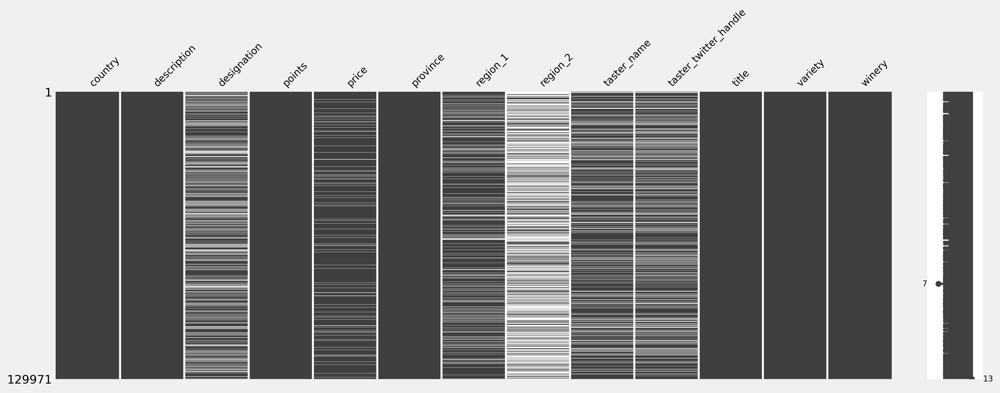

In [8]:
missingno.matrix(df, figsize=(15, 5), fontsize=10)

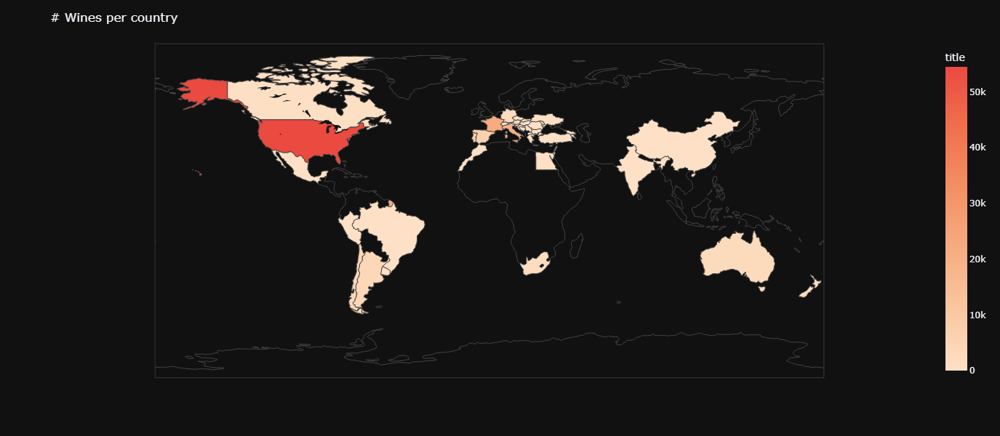

In [9]:
# Generate a choropleth map
country_wines_volume = df.groupby('country')[['title']].count().reset_index()

fig = px.choropleth(country_wines_volume, 
                    locations="country", 
                    locationmode = "country names",
                    color="title",
                    hover_name="country", 
                    color_continuous_scale=px.colors.sequential.Peach)

fig.update_layout(width=1200, height=600, title={'text': '# Wines per country'})
fig.show()

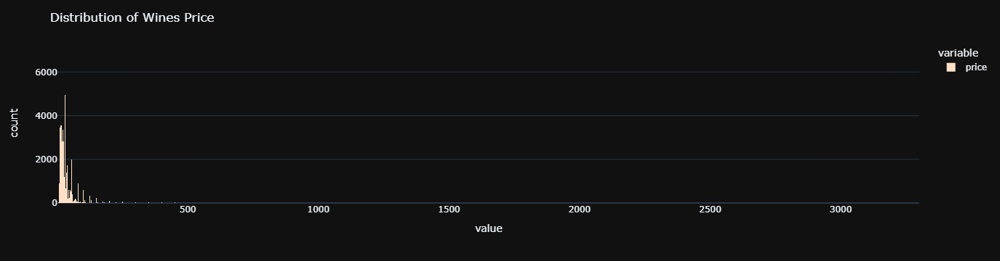

In [10]:
fig = px.histogram(df, x=['price'], color_discrete_sequence=px.colors.sequential.Peach)
fig.update_layout(title={'text': 'Distribution of Wines Price'})
fig.show()

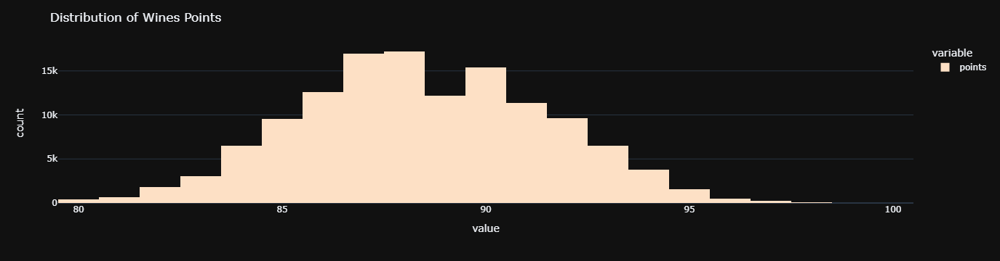

In [11]:
fig = px.histogram(df, x=['points'], color_discrete_sequence=px.colors.sequential.Peach)
fig.update_layout(title={'text': 'Distribution of Wines Points'})
fig.show()

In [12]:
print(f'Points mean: {np.mean(df.points):.2f} \tPoints trimmed mean:  {stats.trim_mean(df.points, 0.1):.2f}')
print(f'Points mean: {np.mean(df.price):.2f} \tPoints trimmed mean:  {stats.trim_mean(df.price, 0.1):.2f}')

Points mean: 88.45 	Points trimmed mean:  88.43
Points mean: 35.36 	Points trimmed mean:  33.23


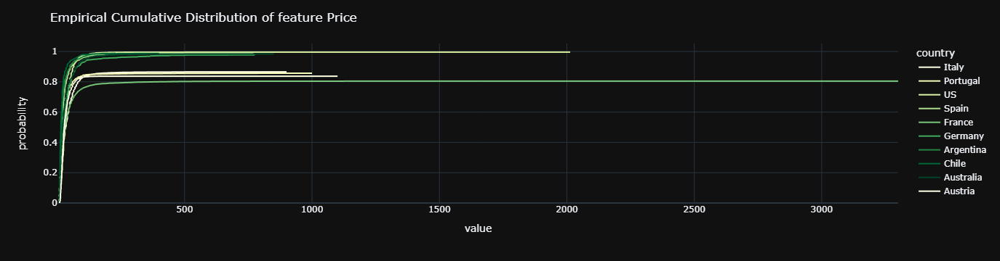

In [13]:
top10_representatives_country = df['country'].value_counts()[:10].index
df_top10_representatives_country = df[df['country'].isin(top10_representatives_country)]
fig = px.ecdf(df_top10_representatives_country, x=['price'], color='country', color_discrete_sequence=px.colors.sequential.YlGn)
fig.update_layout(title={'text': 'Empirical Cumulative Distribution of feature Price'})
fig.show()

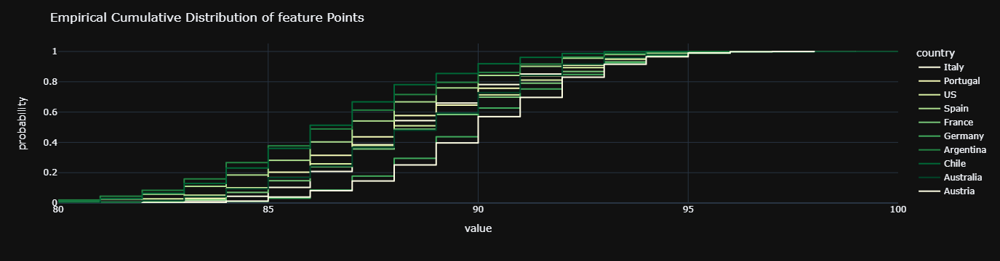

In [14]:
top10_representatives_country = df['country'].value_counts()[:10].index
df_top10_representatives_country = df[df['country'].isin(top10_representatives_country)]
fig = px.ecdf(df_top10_representatives_country, x=['points'], color='country', color_discrete_sequence=px.colors.sequential.YlGn)
fig.update_layout(title={'text': 'Empirical Cumulative Distribution of feature Points'})

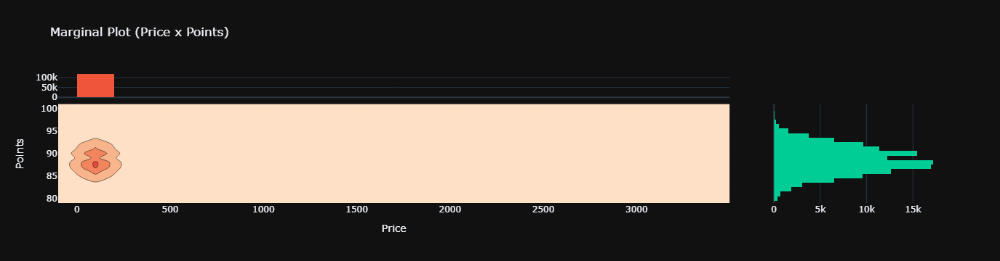

In [15]:
fig = make_subplots(rows=2, cols=2,
                    column_widths=[0.8, 0.2],
                    row_heights=[0.2, 0.8],
                    shared_xaxes=True,
                    shared_yaxes=True,
                    vertical_spacing=0.05,
                    horizontal_spacing=0.05)

# Create a hexbin plot
fig.add_trace(go.Histogram2dContour(x=df["price"], 
                                    y=df["points"], 
                                    colorscale="Peach",
                                    ncontours=7, 
                                    showscale=False,
                                    nbinsx=30,
                                    nbinsy=30,
                                    hovertemplate="Price: $%{x}<br>Points: %{y}<br>Density: %{z}<extra></extra>"),
              row=2, col=1)

# Create the histograms
fig.add_trace(go.Histogram(x=df["price"], 
                           nbinsx=30,
                           showlegend=False,
                           hovertemplate="Price: $%{x}"),
              row=1, col=1)

fig.add_trace(go.Histogram(y=df["points"], 
                           nbinsy=30,
                           showlegend=False,
                           hovertemplate="Points: %{y}", 
                           ),
              row=2, col=2)

# Update the layout and axes properties
fig.update_xaxes(title_text="Price", row=2, col=1)
fig.update_yaxes(title_text="Points", row=2, col=1)
fig.update_xaxes(showticklabels=False, row=1, col=1)
fig.update_yaxes(showticklabels=False, row=2, col=2)

fig.update_layout(title={"text": "Marginal Plot (Price x Points)"})
fig.show()

### Users and Items <> Tasters and Wines

In [16]:
df = df.dropna(subset=['taster_name'])
df = df.dropna(subset=['country'])

In [17]:
df.groupby(['taster_name'])[['country']].count()

,country
taster_name,
Alexander Peartree,415
Anna Lee C. Iijima,4415
Anne Krebiehl MW,3676
Carrie Dykes,139
Christina Pickard,6
Fiona Adams,27
Jeff Jenssen,469
Jim Gordon,4177
Joe Czerwinski,5145


In [18]:
df.groupby(['country'])[['taster_name']].count()

,taster_name
country,
Argentina,3797
Armenia,2
Australia,2037
Austria,3337
Bosnia and Herzegovina,2
Brazil,52
Bulgaria,141
Canada,256
Chile,4361


In [19]:
df['country'] = df['country'].apply(lambda text: re.sub(r'[.,!?;:\'"()\[\]{}&@#$%^_+=×÷<>≤≥-]', '', text))
df['country'] = df['country'].apply(lambda text: unidecode(text).lower())
df['taster_name'] = df['taster_name'].apply(lambda text: re.sub(r'\xa0', '', text))
df['taster_name'] = df['taster_name'].apply(lambda text: unidecode(text).lower())

In [20]:
print(f'Number of duplicated data: {df.duplicated().sum()}')

Number of duplicated data: 8652


In [21]:
df = df.drop_duplicates()

--------
# Creating a <span style="color:Salmon">Recommendation System </span> <span style="color:cornflowerblue">| Collaborative Filtering </span>

In [22]:
# Creating the rank matrix
df_rank = df.pivot_table(index='taster_name', columns='country', values='points', aggfunc='mean')

# Convert the DataFrame to a sparse matrix
sparse_matrix = df_rank.values.T

In [23]:
print(f'#Countrys: {sparse_matrix.shape[0]}\t #Tasters:{sparse_matrix.shape[1]}')

#Countrys: 43	 #Tasters:19


### train - test split

In [24]:
def train_test_split_matrix(matrix, test_rate):
    """
        Sampling data in training and test sets.
    
    ==========
    Parameters
    
    matrix: numpy array
        The rating matrix

    test_rate: float
        The percentage of test set

    ======
    Yields

    train_matrix: numpy array
        The rating training matrix

    test_rate: numpy array
        The rating test matrix
    
    """

    # Extract non-NaN indices
    non_nan_indices = np.argwhere(~np.isnan(matrix))
    
    # Split these indices into train and test
    train_indices, test_indices = train_test_split(non_nan_indices, test_size=test_rate, random_state=911)
    
    # Construct train and test matrices
    train_matrix = np.full(matrix.shape, np.nan)
    test_matrix = np.full(matrix.shape, np.nan)
    
    for i, j in train_indices:
        train_matrix[i, j] = matrix[i, j]
    
    for i, j in test_indices:
        test_matrix[i, j] = matrix[i, j]

    return train_matrix, test_matrix

In [25]:
r_train_holdout, r_test = train_test_split_matrix(sparse_matrix, test_rate=0.15)
r_train, r_valid = train_test_split_matrix(r_train_holdout, test_rate=0.15)

In [26]:
r_train.shape, r_valid.shape, r_test.shape

((43, 19), (43, 19), (43, 19))

In [27]:
nulls = 0
for i in range(r_train.shape[0]):
    if np.isnan(r_train[i]).sum() == r_train.shape[1]:
        nulls+=1

print(f'#Countrys without rank: {nulls}')

#Countrys without rank: 9


In [28]:
nulls = 0
for i in range(r_train.shape[1]):
    if np.isnan(r_train[:, i]).sum() == r_train.shape[0]:
        nulls+=1

print(f'#Tasters without rank: {nulls}')

#Tasters without rank: 1


In [29]:
print('matrix density:')
np.invert(np.isnan(r_train)).sum() / (np.isnan(r_train).sum() + np.invert(np.isnan(r_train)).sum())

matrix density:


0.09791921664626684

-------
### Let's focus on only one taster

In [30]:
tx = 12

In [31]:
df_rank.index[tx]

'michael schachner'

In [32]:
r_train[:, tx]

array([        nan,         nan,         nan,         nan,         nan,
       84.63265306,         nan,         nan, 86.48703384,         nan,
               nan,         nan,         nan,         nan,         nan,
       82.85      ,         nan,         nan,         nan,         nan,
               nan,         nan, 89.17105263,         nan,         nan,
               nan,         nan,         nan,         nan,         nan,
       83.5625    ,         nan,         nan,         nan,         nan,
               nan,         nan,         nan,         nan,         nan,
               nan, 86.66326531, 86.26760563])

In [33]:
tx_avg = np.nanmean(r_train[:, tx])
print(f'{df_rank.index[tx]} average rating: {tx_avg:.2f}')

michael schachner average rating: 85.66


In [34]:
global_avg = np.nanmean(r_train[:, :])
print(f'Global Rating average rating: {global_avg:.2f}')

Global Rating average rating: 87.18


### ... And in only one country

In [35]:
ci = 22

In [36]:
df_rank.columns[ci]

'italy'

In [37]:
r_train[ci, :]

array([        nan,         nan,         nan,         nan,         nan,
               nan,         nan,         nan, 86.03409091, 88.89780344,
               nan,         nan, 89.17105263,         nan,         nan,
       88.67708333,         nan,         nan,         nan])

In [38]:
ci_avg = np.nanmean(r_train[ci, :])
print(f'{df_rank.columns[ci]} average rating: {ci_avg:.2f}')

italy average rating: 88.20


#### The True Rating

In [39]:
r_train[ci, tx]

89.17105263157895

-----
### Global Baseline Estimate

In [40]:
tx_diff_avg = tx_avg - global_avg
ci_diff_avg = ci_avg - global_avg

print(f"The overall avarage difference between {df_rank.index[tx]}'s rates is {tx_diff_avg:.2f} points")
print(f"The overall avarage difference between {df_rank.columns[ci]}'s rates is {ci_diff_avg:.2f} points")

The overall avarage difference between michael schachner's rates is -1.52 points
The overall avarage difference between italy's rates is 1.02 points


In [41]:
baseline_estimator = lambda t, w, g: g + t + w
baseline_estimate_txci = baseline_estimator(tx_diff_avg, ci_diff_avg, global_avg)

In [42]:
baseline_estimate_txci

86.67835639015908

#### Others Countrys Global Baseline 

In [43]:
def baseline(matrix, w, t):

    """
        Calculate the global baseline estimate for a given (t, w)
    
    ==========
    Parameters
    
    matrix: numpy array
        The rating matrix

    t: int
        The taster index
    
    w: int
        The country index

    ======
    Yields

    baseline_estimate: float
        The estimate rating to the r(t, w) 
    
    """
    
    tasters_avg = np.nanmean(matrix[:, t])
    country_avg = np.nanmean(matrix[w, :])
    global_avg = np.nanmean(matrix[:, :])

    tasters_diff_avg = tasters_avg - global_avg
    country_diff_avg = country_avg - global_avg
    
    baseline_estimate = baseline_estimator(tasters_avg, tasters_diff_avg, country_diff_avg)

    return baseline_estimate

------
### Collaborative Filtering

In [44]:
tasters_means = np.nanmean(r_train, axis=0)
tasters_means = np.nan_to_num(x=tasters_means, nan=global_avg) # if have new tasters, fill with global average
tasters_means

array([85.78067885, 86.1990862 , 90.58788886, 86.35658915, 93.        ,
       86.75      , 87.67280805, 88.60355815, 86.86953692, 88.89780344,
       85.38157895, 89.53080817, 85.66201578, 88.97994306, 88.13454047,
       88.74629187, 89.52757765, 85.58347499, 87.17866697])

In [45]:
r_train_centered = r_train - tasters_means[None, :]
r_train_centered = np.nan_to_num(r_train_centered)

In [46]:
cosine_similarity = lambda A, B: np.dot(A, B) / (np.linalg.norm(A) * np.linalg.norm(B))

In [47]:
Countrys_cosine_similarity = [cosine_similarity(r_train_centered[ci], r_train_centered[m])
                            if r_train_centered[m].sum() != 0 else 0
                            for m in range(r_train_centered.shape[0])]

In [48]:
Countrys_cosine_similarity[:10]

[0,
 0.0,
 -0.23156768917512674,
 -0.018920815066425397,
 0,
 -0.9726296382938932,
 0.0,
 -0.04655317393310503,
 0.5911017981162034,
 0.0]

In [49]:
# define k neighbors 
k = 5

np_Countrys_cosine_similarity = np.array(Countrys_cosine_similarity).reshape(-1, )

In [50]:
top_k = pd.DataFrame({'Countrys_sim': np_Countrys_cosine_similarity}).sort_values(by='Countrys_sim', ascending=False).iloc[1: k+1]
kj_index = top_k.index.values
print(f'Top {k} greater similar Countrys: {kj_index}')

Top 5 greater similar Countrys: [41  8 42 37 18]


In [51]:
print(f'Top {k} greater similarity: {top_k.Countrys_sim.values}')

Top 5 greater similarity: [0.97262964 0.5911018  0.33306081 0.11233192 0.00786082]


In [52]:
sum_N_rating = list()
sum_N_similarity = list()
for j in kj_index:
    sij = np_Countrys_cosine_similarity[j]
    rxj = r_train[j, tx]
    bxj = baseline(r_train, j, tx)

    sum_Nrj = sij*(rxj - bxj)
    
    sum_N_rating.append(sum_Nrj)
    sum_N_similarity.append(sij)

    cf = np.nansum(sum_N_rating) / np.nansum(sum_N_similarity)

In [53]:
rxi = baseline_estimate_txci + cf

In [54]:
rxi

89.26913061143844

------
### Evaluating

In [55]:
def root_mean_squared_error(r_true, r_pred):
    """
        Sampling data in training and test sets.
    
    ==========
    Parameters
    
    r_true: numpy array
        The true rating matrix

    r_true: numpy array
        The prediction rating matrix

    ======
    Yields

    rmse: float
        The root mean square error
    """
    
    # Get indices where the value is not np.nan
    idx = np.where(~np.isnan(r_true))
    paired_idx = list(zip(idx[0], idx[1]))
    N = np.invert(np.isnan(r_true)).sum()
    ssr = 0
    
    for r, c in paired_idx:
        # if we have ratings to compare
        if r_pred[r, c] != np.nan:
            ssr += (r_pred[r, c] - r_true[r, c])**2
        # if we don't have the true rating
        else: 
            pass 

    rmse = (ssr/N)**0.5
    return rmse

In [56]:
# Let create arrays to compare our sample rating
rxi = np.array([rxi]).reshape(1, 1)
rxr = np.array([r_train[ci, tx]]).reshape(1, 1)

In [57]:
print(f"The get RMSE by {df_rank.index[tx]}'s real rating about {df_rank.columns[ci]} and the predicted value:")
root_mean_squared_error(rxr, rxi)

The get RMSE by michael schachner's real rating about italy and the predicted value:


0.09807797985949662

----------
## Let's make a full pipeline to predict ratings 

In [58]:
from sklearn.base import BaseEstimator, RegressorMixin
from sklearn.utils.validation import check_is_fitted

In [59]:
class RatingEstimator(BaseEstimator, RegressorMixin):
    """
        A wine nationalitys ratings estimator

    ==========
    Parameters

    k_neighbors: int
        The number of neighbors to be involved in the mathematical rating estimator
    """
    def __init__(self, k_neighbors=3):
        self.k_neighbors = k_neighbors

    def fit(self, ratings):
        """
        Fit the estimator to the training data.
        Just save the matrix.

        ==========
        Parameters
        
        ratings: np.array
            The ratings we have
        """
        self.r_matrix = ratings
        
        # Custom attribute to track if the estimator is fitted
        self._is_fitted = True
        return self

    def _baseline_estimate(self):
        """ 
            The baseline estimator part

        ======
        Yields
        
        self.global_avg: float
            The global baseline estimate
        """        
        try:
            self.global_avg =  np.nanmean(self.r_matrix[:, :])
            self.tx_avg = np.nanmean(self.r_matrix[:, self.taster_idx])
            self.tx_diff_avg = self.tx_avg - self.global_avg
            self.ci_avg = np.nanmean(self.r_matrix[self.country_idx, :])
            self.ci_diff_avg = self.ci_avg - self.global_avg
        
            return baseline_estimator(self.tx_diff_avg, self.ci_diff_avg, self.global_avg)

        except:
            return self.global_avg        

    @staticmethod
    def _calculate_cosine_similarity(ratings, ci):
        """ 
            Calculate the cosine similarity between two vectors

        ==========
        Parameters

        ratings: np.array
            The ratings we have

        ci: int
            The country thay will by considered
        
        ======
        Yields
        
        Countrys_cosine_similarity: float
            The similarity
        """        
        
        tasters_means = np.nanmean(ratings, axis=0)
        tasters_means = np.nan_to_num(x=tasters_means, nan=global_avg) # if have new tasters, fill with global average
        
        ratings_centered = ratings - tasters_means[None, :]
        ratings_centered = np.nan_to_num(ratings_centered, nan=0.0)
        
        Countrys_cosine_similarity = [cosine_similarity(ratings_centered[ci], ratings_centered[m])
                                    if ratings_centered[m].sum() != 0 else 0
                                    for m in range(ratings_centered.shape[0])]
        return Countrys_cosine_similarity


    def _collaborative_filtering(self, k):
        """ 
            A collaborative filtering estimation part

        ==========
        Parameters

        k: int
            The number of neighbors to be involved in the mathematical rating estimator
        
        ======
        Yields
        
        cf: float
            The collaborative filtering estimation
        """        
        
        try:
            self.countrys_cosine_similarity = RatingEstimator._calculate_cosine_similarity(self.r_matrix, self.country_idx)
            np_countrys_cosine_similarity = np.array(self.countrys_cosine_similarity).reshape(-1, )
            top_k = pd.DataFrame({'countrys_sim': np_countrys_cosine_similarity}).sort_values(by='countrys_sim', ascending=False).iloc[1: k+1]
            self.kj_index = top_k.index.values
            self.k_sim = top_k.countrys_sim.values
    
            sum_N_rating = list()
            sum_N_similarity = list()
            for j in self.kj_index:
                sij = np_countrys_cosine_similarity[j]
                rxj = self.r_matrix[j, self.taster_idx]
                bxj = baseline(self.r_matrix, j, self.taster_idx)
            
                sum_Nrj = sij*(rxj - bxj)
                
                sum_N_rating.append(sum_Nrj)
                sum_N_similarity.append(sij)
            
                cf = np.nansum(sum_N_rating) / np.nansum(sum_N_similarity)
    
            return cf

        except:
            return 0.0
            
    def predict(self, taster, country):
        """
        Perform Predictions

        ======
        Yields
        final_estimation: float
            Fulled estimation          
        """
        
        self.taster_idx = taster
        self.country_idx = country
        
        self.baseline_estimate_txci = RatingEstimator._baseline_estimate(self)
        self.cf_txci = RatingEstimator._collaborative_filtering(self, self.k_neighbors)  

        final_estimation = self.baseline_estimate_txci + self.cf_txci
        
        return final_estimation

    def score(self):
        """
        Calculate RMSE Score
        """
        
        rxi = np.array([self.baseline_estimate_txci + self.cf_txci]).reshape(1, 1)
        rxr = np.array([self.r_matrix[self.country_idx, self.taster_idx]]).reshape(1, 1)
        
        return root_mean_squared_error(rxi, rxr)

In [60]:
rating_estimator = RatingEstimator(k_neighbors=k)

In [61]:
rating_estimator = rating_estimator.fit(r_train)

In [62]:
rating_estimator.predict(tx, ci)

89.26913061143844

In [63]:
rating_estimator.score()

0.09807797985949662

### Checking it on validation set

In [64]:
# Get indices where the value is not np.nan
valid_indices = np.where(~np.isnan(r_valid))
valid_paired_indices = list(zip(valid_indices[0], valid_indices[1]))

In [65]:
r_pred = np.full(r_valid.shape, np.nan)

for i, j in valid_paired_indices:
    rating_estimator = RatingEstimator(k_neighbors=5)
    rating_estimator.fit(r_train)
    pred = rating_estimator.predict(i, j)
    r_pred[i, j] = pred

In [66]:
root_mean_squared_error(r_pred, r_valid)

3.0551220503792593

### Learning curve on k-neighbors

In [67]:
train_indices = np.where(~np.isnan(r_train))
train_paired_indices = list(zip(train_indices[0], train_indices[1]))

In [68]:
r_train_pred = np.full(r_valid.shape, np.nan)
r_valid_pred = np.full(r_valid.shape, np.nan)

k_list = np.arange(1, 10)
train_rmse_list = list()
valid_rmse_list = list()

for k in k_list:
    rating_estimator = RatingEstimator(k_neighbors=k)
    rating_estimator = rating_estimator.fit(r_train)
    
    for i, j in train_paired_indices:
        pred = rating_estimator.predict(i, j)
        r_train_pred[i, j] = pred

    train_rmse_list.append(root_mean_squared_error(r_train_pred, r_train))
    
    for i, j in valid_paired_indices:
        pred = rating_estimator.predict(i, j)
        r_valid_pred[i, j] = pred

    valid_rmse_list.append(root_mean_squared_error(r_valid_pred, r_valid))

Text(0.5, 1.0, 'valid')

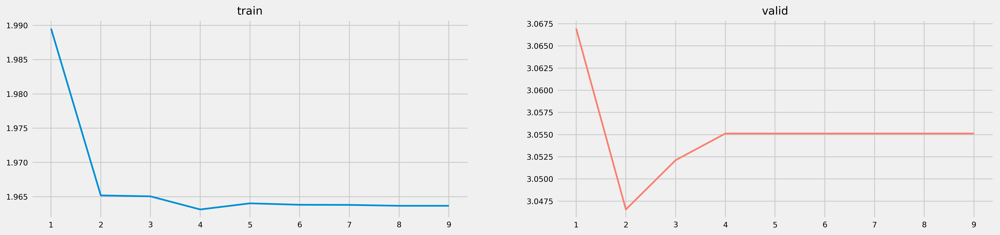

In [69]:
f, ax = plt.subplots(1, 2, figsize=(18, 4))
ax[0].plot(k_list, train_rmse_list)
ax[1].plot(k_list, valid_rmse_list, color='salmon')
ax[0].set_title('train')
ax[1].set_title('valid')

### Now in test-set with best _k_

In [70]:
k = 2
rating_estimator = RatingEstimator(k_neighbors=k)
rating_estimator = rating_estimator.fit(r_train_holdout)

r_train_holdout_pred = np.full(r_valid.shape, np.nan)
train_holdout_indices = np.where(~np.isnan(r_train))
train_holdout_paired_indices = list(zip(train_holdout_indices[0], train_holdout_indices[1]))

for i, j in train_holdout_paired_indices:
        pred = rating_estimator.predict(i, j)
        r_train_holdout_pred[i, j] = pred

root_mean_squared_error(r_train_holdout_pred, r_train_holdout)

2.252778500002268

That's quite ok, perfome better than valid set.

---------
## Making recommendations

In [71]:
print(f"To test we will recommend nationalities of wines for {df_rank.index[tx]}")

To test we will recommend nationalities of wines for michael schachner


In [72]:
# select only nationalitys that he don't taste yet
null_values = np.where(np.isnan(sparse_matrix[:, tx]))

In [73]:
# refit
final_rating_estimator = RatingEstimator(k_neighbors=k)
final_rating_estimator = final_rating_estimator.fit(sparse_matrix)

ratings_preds = {}

for i in null_values[0]:
        pred = rating_estimator.predict(i, tx)
        ratings_preds[df_rank.columns[i]] = pred

df_ratings_preds = pd.DataFrame(ratings_preds, index=['ratings_pred']).T

In [74]:
df_ratings_preds.sort_values(by='ratings_pred', ascending=False)[:5]

,ratings_pred
bosnia and herzegovina,92.569631
australia,90.157520
cyprus,89.100440
georgia,89.097209
greece,88.790578
